nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 4.

## Scenario 1. Convolutional Neural Network
 * Reading Dataset File
 * Building CNN
  - ReLU activation function
  - Convolution Layer
  - Pooling Layer
  - Fully Connected Layer
 * Overfitting
  - High bias
  - High variance
 * Drop-Out Layer

### Reading Dataset File

 * tfrecord로 저장된 데이터셋을 Dataset Class를 이용하여 Read
 * Pipeline 다루는데 매우 간편한 클래스로 설계되어 있으므로, Binary File은 tfrecord 활용 권장

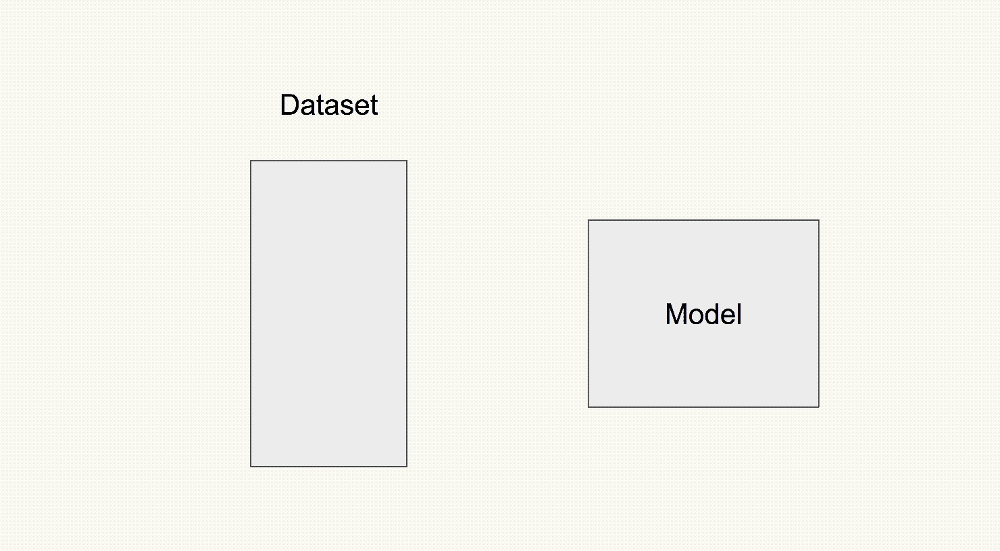

In [2]:
Image('./day2/pipeline.gif.png')

### Building CNN

 * Convolutional Neural Network의 약자로써 Image Processing에서 강력한 성능
 * 현존하는 Neural Network 중에서 가장 빠른 모델로써 Image 외에도 많은 분야에서 CNN 기반 모델 활용
 * 모델 내에서 Feature Extract, Classify가 자체적으로 수행

 * 기존 FFNN hidden layer
$$ h^{n} = \sigma(W_{n-1}^Th^{n-1} + b) \cdots FFNN's\ hidden\ layer $$ <br>

 * CNN의 convolution layer
 
$$ h^{n} = ReLU(W_{n-1}^T*h^{n-1} + b) \cdots CNN's\ convolution\ layer $$ <br>

$\star$ CNN에서 바뀐 것
 * matmul $\rightarrow$ convolution
 * sigmoid activation $\rightarrow$ ReLU activation

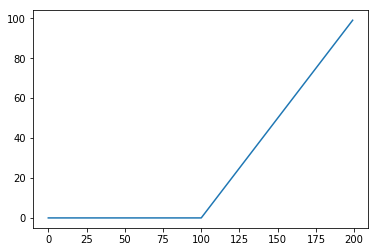

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

relu = [i if i > 0 else 0 for i in range(-100, 100)]
plt.plot(relu)
plt.show()

#### convolution layer

 * FFNN의 dot product대신 convolution을 사용
 * FFNN의 hidden layer는 input, output 크기에 영향을 받기 때문에 차원이 증가할수록 연산량이 기하급수적으로 늘어남
 * CNN의 hidden layer의 convolution 연산은 input, output의 크기에 영향을 받지 않기 때문에 연산량 크게 감소
 * input feature에 대해 일정한 크기의 W가 공유되기 때문에 output에 영향을 끼치는 feature에 대해서 반응 $\rightarrow$ featrue extract
 * W 공유 (weight sharing)에서 나타나는 이점 $\rightarrow$ Memory 점유 감소, 연산량 감소

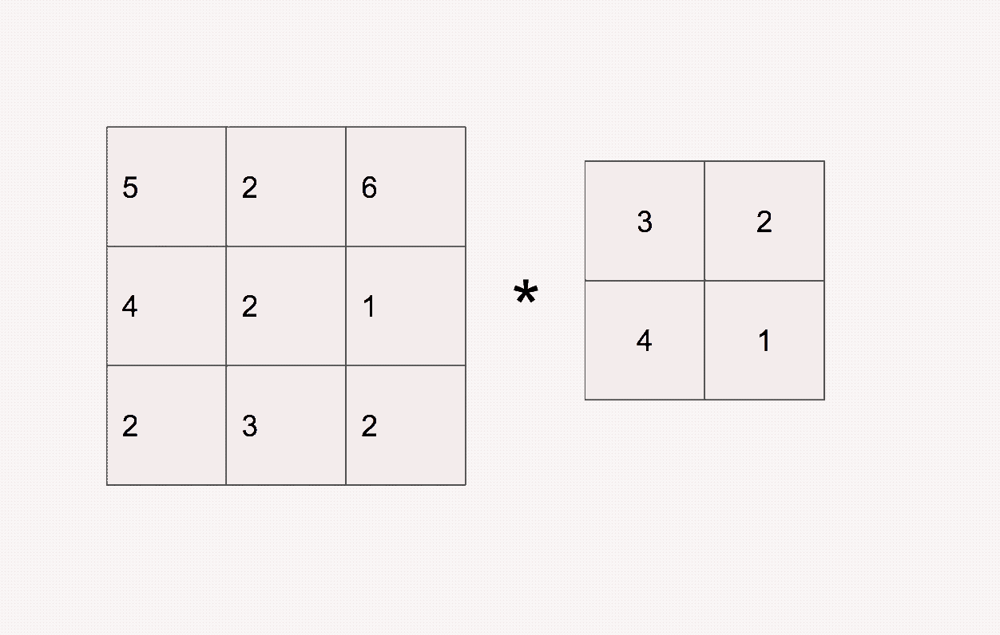

In [4]:
Image('./day4/convolution.gif.png')

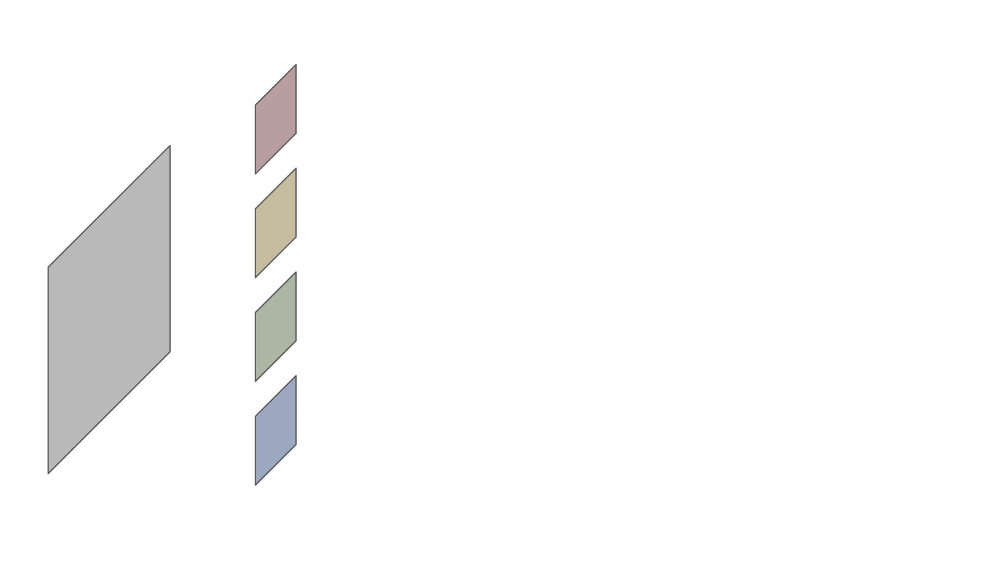

In [5]:
Image('./day4/conv_layer.gif.png')

#### pooling layer

 * Image pyramid를 형성하기 위한 layer
 * W 크기는 한정되어 있고, 인식하고자 하는 객체의 크기는 정해져 있지 않기 때문에 Image pyramid를 통해 스케일 변화에 따른 인식률 변화 보정
 * 추출된 feature 중 score가 가장 높은 feature를 선택함으로써 학습 집중도 향상
 * 연산량 감소 목적

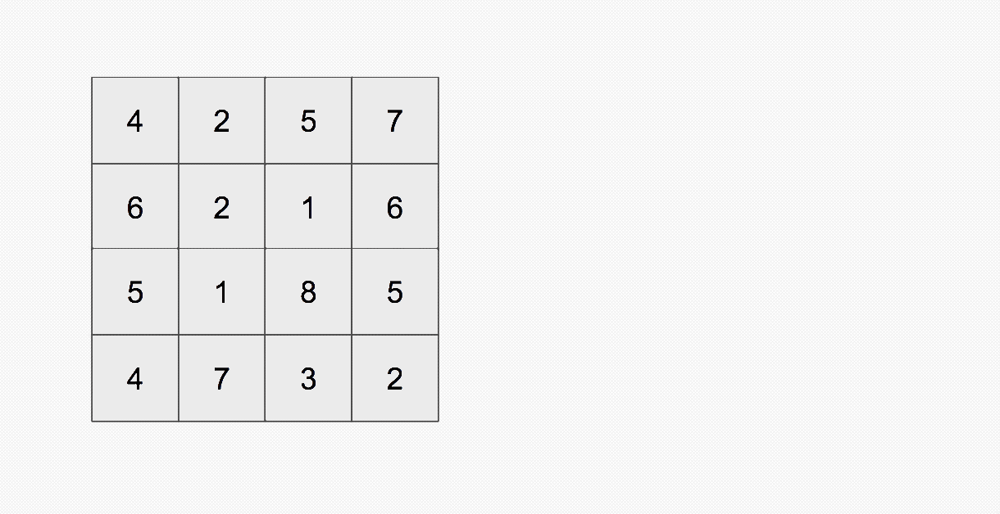

In [6]:
Image('./day4/maxpool.gif.png')

#### fully connected layer

 * FFNN과 같은 dense layer로 구성
 * convolution layer에서 추출한 feature를 classify 하는 역할
 * CNN 모델의 속도 강하의 주범
 * 최근 CNN 기반 모델에서는 이 Fully connected layer도 제거하는 방향으로 연구 진행(이 마저도 convolution으로 대체하고 있다)

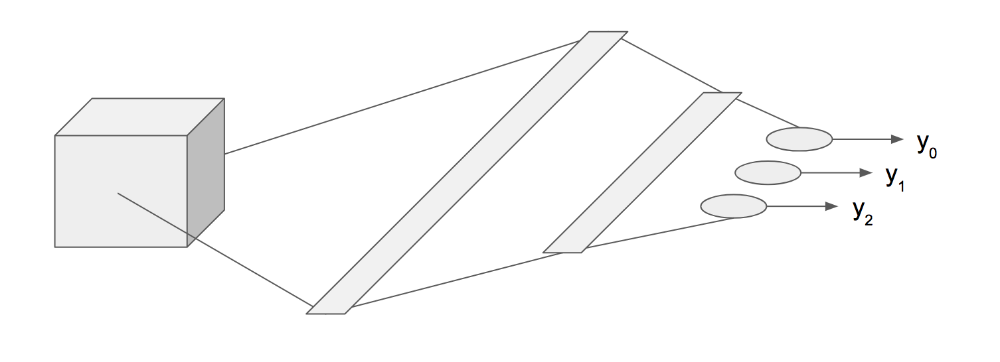

In [7]:
Image('./day4/fclayer.png')

### Overfitting

 * 시험 문제가 어려운 이유
 * 공부한건 시험에 안나옴

#### high bias

 * 공부는 엄청나게 열심히 하지만 성적이 안오르는 스타일
 * 시험 문제는 유형이 있기 마련인데 유형 파악을 잘 못함

모의고사도 망하고

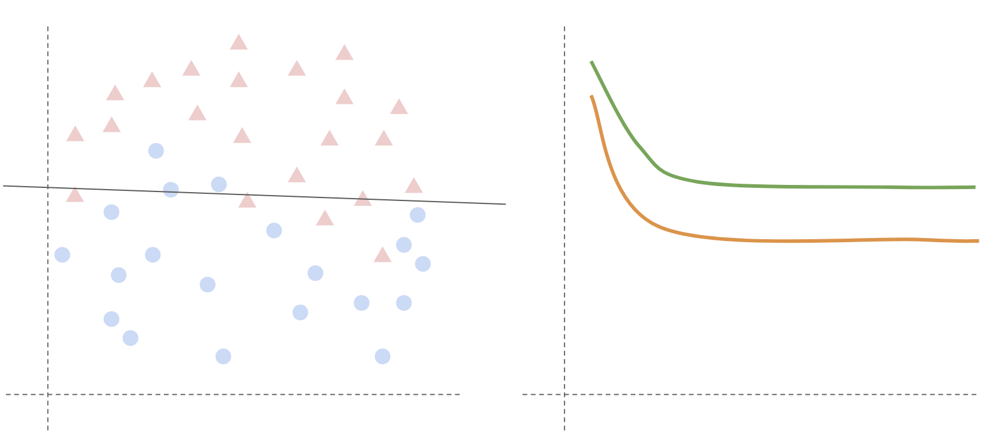

In [8]:
Image('./day4/high_bias_train.png')

수능도 망함

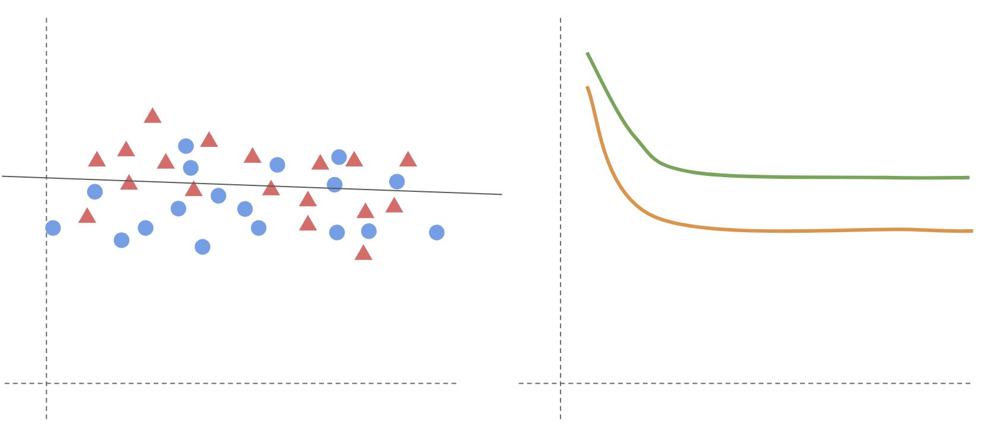

In [9]:
Image('./day4/high_bias_test.png')

####  high variance

 * 예상 문제만 달달 외움
 * 시험에 안나옴

답까지 다 외웠는데

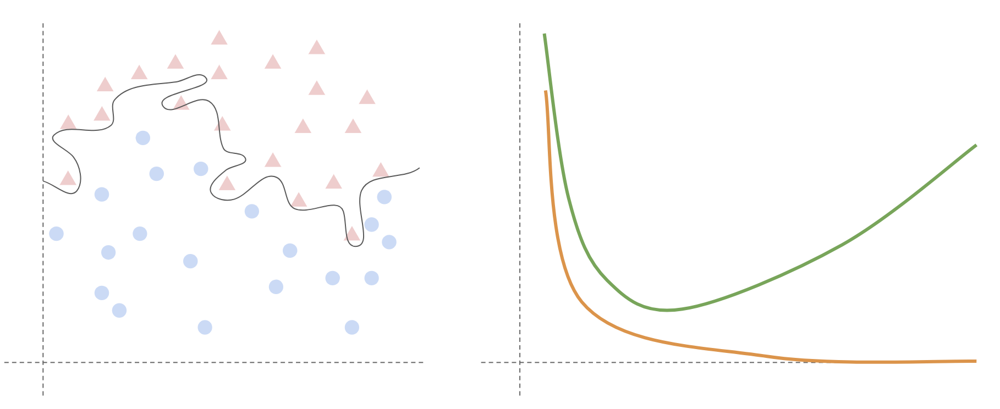

In [10]:
Image('./day4/high_variance_train.png')

시험에 안나와서 망함

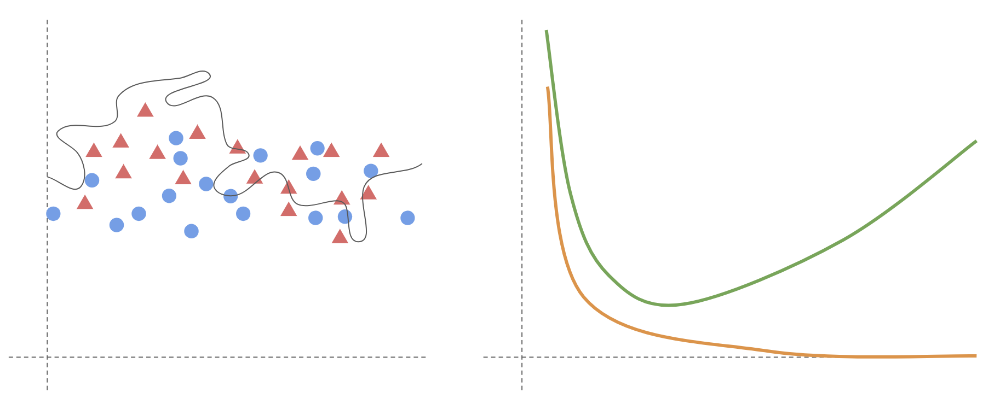

In [11]:
Image('./day4/high_variance_test.png')

### Drop-out

 * 공부 편식은 나쁜 습관(Overfitting의 원인) 
 * 뇌를 골고루 써야 공부를 잘 할 수 있다.
 * Weight Update가 골고루 될 수 있도록 매 train step마다 일정 확률로 connection을 끊어줌(학습방지)
 * 끊어진 connection에 대한 prediction은 loss에 반영되지 않으므로 weight를 골고루 학습 가능

미분 적분은 다 풀면서 확률 통계만 나오면 다 틀리는 사람

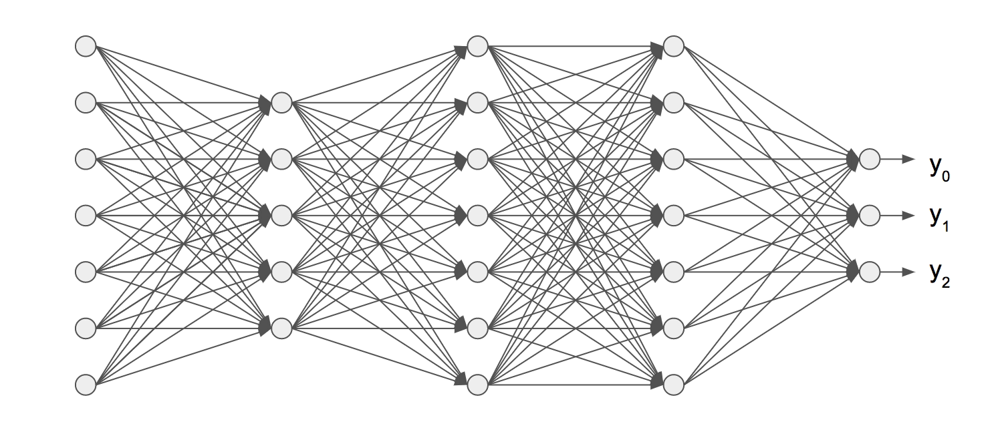

In [12]:
Image('./day4/no_dropout.gif.png')

미분 적분, 확률 통계 가리지 않고 골고루 공부해서 90점 이상 맞는 사람

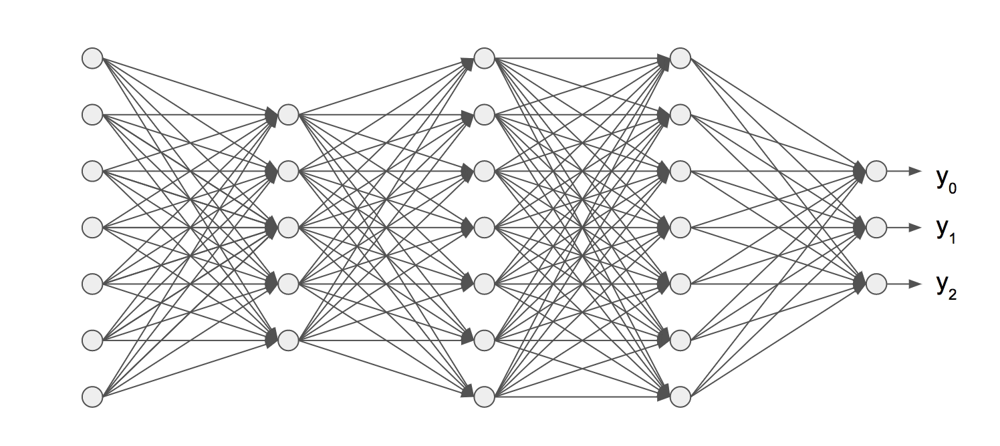

In [13]:
Image('./day4/dropout.gif.png')

### Implementation

In [14]:
import tensorflow as tf

In [15]:
def parser(serialized_example):
    features = {
        'age': tf.FixedLenFeature([1], tf.int64),
        'img': tf.FixedLenFeature([61*49], tf.int64)
    }
    
    parsed_feature = tf.parse_single_example(serialized_example, features)
    age = parsed_feature['age']
    img = parsed_feature['img']
    return age, img

In [16]:
tf.reset_default_graph()

face_train = './cnn_dataset/face_train.tfrecord'
face_test = './cnn_dataset/face_test.tfrecord'

train_dataset = tf.contrib.data.TFRecordDataset(face_train).map(parser)
train_dataset = train_dataset.batch(32).shuffle(7777)

test_dataset = tf.contrib.data.TFRecordDataset(face_test).map(parser)
test_dataset = test_dataset.batch(32).shuffle(7777)

itr = tf.contrib.data.Iterator.from_structure(train_dataset.output_types, train_dataset.output_shapes)
age, img = itr.get_next()

img = tf.reshape(img, [-1, 61, 49, 1])
img = tf.cast(img, tf.float32)

age = tf.reshape(age, [-1])
age_onehot = tf.one_hot(age, depth=3, axis=-1)

training_init_op = itr.make_initializer(train_dataset)
test_init_op = itr.make_initializer(test_dataset)

In [17]:
def model(x, activation, dropout_prob, reuse=False):
    conv1 = tf.layers.conv2d(img, filters=10, kernel_size=3, padding='SAME', 
                             activation=activation, reuse=reuse, name='conv1')
    pool1 = tf.layers.max_pooling2d(conv1, pool_size=2, strides=2)
    conv2 = tf.layers.conv2d(pool1, filters=10, kernel_size=3, padding='SAME', 
                             activation=activation, reuse=reuse, name='conv2')
    pool2 = tf.layers.max_pooling2d(conv2, pool_size=2, strides=2)
    conv3 = tf.layers.conv2d(pool2, filters=10, kernel_size=3, padding='SAME', 
                             activation=activation, reuse=reuse, name='conv3')
    pool3 = tf.layers.max_pooling2d(conv3, pool_size=2, strides=2)

    flat_size = int(pool3.shape[1]) * int(pool3.shape[2]) * int(pool3.shape[3])
    flat = tf.reshape(pool3, [-1, flat_size])

    dropout1 = tf.layers.dropout(flat, dropout_prob)
    fc1 = tf.layers.dense(dropout1, 1000, reuse=reuse, name='fc1')

    dropout2 = tf.layers.dropout(fc1, dropout_prob)
    out = tf.layers.dense(dropout2, 3, reuse=reuse, name='out')        
    return out


train_out = model(img, tf.nn.relu, 0.7)
test_out = model(img, tf.nn.relu, 1.0, True)

loss = tf.losses.softmax_cross_entropy(age_onehot, train_out)
train_op = tf.train.GradientDescentOptimizer(1e-6).minimize(loss)

pred = tf.argmax(tf.nn.softmax(test_out), axis=1)
accuracy = tf.metrics.accuracy(age, pred)

In [18]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    sess.run(tf.local_variables_initializer())
    for epoch in range(10):
        sess.run(training_init_op)
        for train_step in range(999999):
            try:
                _, _loss = sess.run([train_out, loss])
                    
            except tf.errors.OutOfRangeError:
                break
                
        sess.run(test_init_op)
        for test_step in range(9999999):
            try:
                _acc = sess.run(accuracy)
                    
            except tf.errors.OutOfRangeError:
                break
                
        print('epochs: {}, loss: {}, acc: {}'.format(epoch, _loss, _acc[0]))



epochs: 0, loss: 12.03184700012207, acc: 0.3271152675151825
epochs: 1, loss: 10.545997619628906, acc: 0.3243243098258972
epochs: 2, loss: 14.210671424865723, acc: 0.3240639269351959
epochs: 3, loss: 11.574151992797852, acc: 0.32459017634391785
epochs: 4, loss: 11.331686019897461, acc: 0.3239879608154297
epochs: 5, loss: 15.725924491882324, acc: 0.3234780728816986
epochs: 6, loss: 29.930294036865234, acc: 0.3242359161376953
epochs: 7, loss: 22.875673294067383, acc: 0.32406800985336304
epochs: 8, loss: 40.32627487182617, acc: 0.32430076599121094
epochs: 9, loss: 9.716495513916016, acc: 0.32370245456695557
